In [ ]:
from google.colab import files
files.upload()


Saving California_reviews_c.csv to California_reviews_c.csv


{'California_reviews_c.csv': b',_id,review_id,user_id,business_id,stars,useful,funny,cool,text,date,year\n0,{\'$oid\': \'638f00230bb395a4ffda34b4\'},SGVGJQ2EiAumz1ofc2T54g,vaAEyqOPZcn_3F-1nzsenQ,KC8_Rx4Orlsz8LIonCYXsA,3,0,0,0,"This place was ok.  I was hoping for some great beer, but instead I had some basic, watered down, flavor water.  Their stout was very good.  I had the sampler and was not too impressed.  The bartender was too cool for school, but was still quick with a pour.  We were seated at the bar near some yuppie loud dudes, but they left shortly after our arrival.  The layout of the bar is nice and I don\'t regret stopping in and giving them a try.  My buddy had a ""golden something or other"" and he said it was great.",2012-06-20 14:55:40,2012\n1,{\'$oid\': \'638f00230bb395a4ffda354c\'},5VWz3KmMp4mq9agrL_sWZQ,Y-SzX4gmeVqu1_JSjTx7RA,9u79dIXLQzmt9rnOZEnBaQ,5,2,3,1,"Get the kid\'s burger meal and add cheese, tomatoes and lettuce. It is the perfect size. It comes with a teeny 

In [6]:
!pip install scikit-surprise



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 771 kB 5.2 MB/s 
  Created wheel for scikit-surprise: filename=scikit_surprise-1.1.3-cp38-cp38-linux_x86_64.whl size=2626481 sha256=7351d9688bea882c590be04f8f223a9cd6f670ce8a1876535b4c7debe4d0ae3c
  Stored in directory: /root/.cache/pip/wheels/af/db/86/2c18183a80ba05da35bf0fb7417aac5cddbd93bcb1b92fd3ea
Successfully built scikit-surprise


In [7]:
from surprise import NMF
import warnings
warnings.filterwarnings('ignore')

In [8]:
import pandas as pd
from surprise import Dataset, Reader
from surprise import accuracy
from surprise.model_selection import train_test_split
from surprise.model_selection import GridSearchCV
from surprise.model_selection import KFold
from surprise import NMF
from surprise import BaselineOnly
from surprise import SVDpp
from surprise import NormalPredictor
from surprise import KNNBaseline
from surprise import KNNBasic
from surprise import KNNWithMeans
from surprise import CoClustering
from surprise import SVD
from surprise.model_selection import cross_validate
import matplotlib as plt


In [17]:
reviews = pd.read_csv('California_reviews_c.csv', usecols= ['business_id', 'stars', 'review_id', 'user_id'])
business = pd.read_csv('business.csv', usecols= ['business_id', 'name'])
users = pd.read_csv('CA_users_c.csv', usecols= ['user_id','name','is_elite'])


In [18]:
## Since users and business dataframe both have the same column names we will update them accordingly
users = users.rename(columns = { 'name': 'Username' })
business = business.rename(columns = { 'name': 'Restaurant name' })


In [19]:

reviews.columns
reviews.head()

,review_id,user_id,business_id,stars
0,SGVGJQ2EiAumz1ofc2T54g,vaAEyqOPZcn_3F-1nzsenQ,KC8_Rx4Orlsz8LIonCYXsA,3
1,5VWz3KmMp4mq9agrL_sWZQ,Y-SzX4gmeVqu1_JSjTx7RA,9u79dIXLQzmt9rnOZEnBaQ,5
2,OBgljJsqYKQihXC1q_e5rQ,FczCp38lpeYAQRCL9PQ5rw,9u79dIXLQzmt9rnOZEnBaQ,5
3,HJCjJcCkDEJ5yfbIdLuAXQ,hr4ZCUwACcidRjnnjZVxZQ,v4AMcIZ--hXZuJIg3luUgg,5
4,7NUfmZ5Kfr6Gl9IG8j8sAQ,4FXn5evsrPcGnYa1FsLGmw,sor6oj-nuslOcSx7di4urA,5


In [20]:
reviews.isnull()

,review_id,user_id,business_id,stars
0,False,False,False,False
1,False,False,False,False
2,False,False,False,False
3,False,False,False,False
4,False,False,False,False
...,...,...,...,...
37036,False,False,False,False
37037,False,False,False,False
37038,False,False,False,False
37039,False,False,False,False


In [21]:
business.columns


Index(['business_id', 'Restaurant name'], dtype='object')

In [22]:
users.columns

Index(['user_id', 'Username', 'is_elite'], dtype='object')

In [23]:

users.head()


,user_id,Username,is_elite
0,UX5F5uklksvo-MTPFMD_kQ,Customers'Experience,False
1,DKg1g4YdyJE5VnSKE3A8xQ,Cory,False
2,rAwpi3P0xp-3S6Fzgjpvnw,Devin,False
3,UdKQcwk0kLf4AXtKGDvw4w,gerri,False
4,rue63aaJc5qpmruNlML-Lg,Noelle,False


In [24]:
elite_reviews_df = reviews.merge(users, how='left', on=['user_id'], indicator=True)
elite_reviews_df.shape


(53562, 7)

In [25]:

elite_reviews_df = elite_reviews_df.loc[elite_reviews_df['is_elite'] == True]
elite_reviews_df.shape

(2042, 7)

In [26]:
reader = Reader(rating_scale=(1, 5))

# The columns must correspond to user id, business id and stars (in that order).
data = Dataset.load_from_df(elite_reviews_df[['user_id', 'business_id', 'stars']], reader)

In [27]:
data

# Item based Collaborative Filtering Using BaselineOnly:
BaselineOnly algorithm predicts the baseline estimate for given user and item. BaselineOnly algorithm gave us the good rmse score, therefore, we will trying to train and predict with BaselineOnly and use Alternating Least Squares (ALS)


In [28]:
benchmark = []

# Iterate over all algorithms
for algorithm in [SVD(), SVDpp(), NMF(), NormalPredictor(), KNNBaseline(), KNNBasic(), KNNWithMeans(), BaselineOnly(), CoClustering()]:
    # Perform cross validation
    results = cross_validate(algorithm, data, measures=['RMSE'], cv=3, verbose=False)
    
    # Get results & append algorithm name
    tmp = pd.DataFrame.from_dict(results).mean(axis=0)
    tmp = tmp.append(pd.Series([str(algorithm).split(' ')[0].split('.')[-1]], index=['Algorithm']))
    benchmark.append(tmp)
    
pd.DataFrame(benchmark).set_index('Algorithm').sort_values('test_rmse')  


Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Estimating biases using als...
Estimating biases using als...


,test_rmse,fit_time,test_time
Algorithm,,,
KNNWithMeans,0.725740,0.040812,0.063223
KNNBaseline,0.727914,0.047394,0.063085
NMF,0.729302,0.134093,0.012149
KNNBasic,0.747860,0.016285,0.035415
SVD,0.863884,0.052994,0.009248
SVDpp,0.877462,0.044783,0.019262
CoClustering,0.897620,0.084367,0.003720
BaselineOnly,0.986519,0.003715,0.003790
NormalPredictor,1.426664,0.008740,0.008332


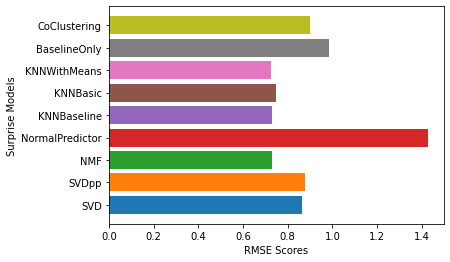

In [30]:
import matplotlib.pyplot as plt
def plot(benchmark):
    for index in benchmark:
        plt.barh(index[3], index[0], align = 'center', alpha = 1)
    plt.ylabel('Surprise Models')
    plt.xlabel('RMSE Scores')
 
plot(benchmark)

In [31]:
param_grid = {'bsl_options':{
                'method': ['als','sgd'],
                'n_epochs': [2, 5, 10], 
                'lr_all': [0.001, 0.002, 0.005],
                'reg_all': [0.01, 0.2, 0.4, 0.6],
                'reg_u': [2, 5, 12, 15],
                'reg_i': [2, 5, 10]
                }
             }

bsl_algo = BaselineOnly()


In [32]:
gs = GridSearchCV(BaselineOnly, param_grid, measures=['rmse'], cv=KFold(6, random_state=2,shuffle = True),n_jobs=-1)

gs.fit(data)

# best RMSE score
print(gs.best_score['rmse'])

# combination of parameters that gave the best RMSE score
print(gs.best_params['rmse'])


0.751438167164013
{'bsl_options': {'method': 'als', 'n_epochs': 10, 'lr_all': 0.001, 'reg_all': 0.01, 'reg_u': 2, 'reg_i': 2}}


In [33]:
kf = KFold(n_splits=6)
baselineonly = gs.best_estimator['rmse']

for trainset, testset in kf.split(data):
    # train and test algorithm.
   
    baselineonly.fit(trainset)

    predictions_bsl = baselineonly.test(testset)
    # Compute and print Root Mean Squared Error
    rmse = accuracy.rmse(predictions_bsl)

Estimating biases using als...
RMSE: 0.7098
Estimating biases using als...
RMSE: 0.7889
Estimating biases using als...
RMSE: 0.7429
Estimating biases using als...
RMSE: 0.7398
Estimating biases using als...
RMSE: 0.7643
Estimating biases using als...
RMSE: 0.7828


# Item based Collaborative Filtering Using SVD

In [34]:
param_grid_SVD = {
'n_factors':[5,15,20,25],
'n_epochs': [10, 20, 30], 
'lr_all': [0.005, 0.007],
'reg_all': [0.01,0.03,0.05,0.07],
}
svd_algo = SVD()


In [35]:
gs_svd = GridSearchCV(SVD, param_grid_SVD, measures=['rmse'], cv=KFold(6, random_state=2,shuffle = True),n_jobs=-1)

gs_svd.fit(data)

# best RMSE score
print(gs_svd.best_score['rmse'])

# combination of parameters that gave the best RMSE score
print(gs_svd.best_params['rmse'])

0.7317479189993173
{'n_factors': 25, 'n_epochs': 30, 'lr_all': 0.007, 'reg_all': 0.01}


In [36]:
kf = KFold(n_splits=6)
svd = gs_svd.best_estimator['rmse']

for trainset, testset in kf.split(data):
    # train and test algorithm.
   
    svd.fit(trainset)

    predictions_svd = svd.test(testset)
    # Compute and print Root Mean Squared Error
    rmse = accuracy.rmse(predictions_svd)

RMSE: 0.7244
RMSE: 0.8131
RMSE: 0.7330
RMSE: 0.7360
RMSE: 0.6431
RMSE: 0.7768


#Recommendation Model:
Prediction of restaurant ratinga nd recommendation of restaurants to users

In [37]:
# Combine the columns from the given dataframe to consist only of required columns for model
ratings_data = reviews.join(business.set_index('business_id'), on='business_id')
ratings_data = ratings_data.join(users.set_index('user_id'), on = 'user_id')
#filterinmg only elite user again
ratings_data=ratings_data.loc[ratings_data['is_elite'] == True]

ratings_data

,review_id,user_id,business_id,stars,Restaurant name,Username,is_elite
17,lQK8e_UiJbR-nH6JFA_KfQ,6V1pBVLdo71JplcLS71rRw,omnCKxL0f_akh0eYeJxjDg,4,Seven Bar & Kitchen,Leila,True
17,lQK8e_UiJbR-nH6JFA_KfQ,6V1pBVLdo71JplcLS71rRw,omnCKxL0f_akh0eYeJxjDg,4,Seven Bar & Kitchen,Leila,True
59,4pL7C7Y458E8jUd0C0aEUw,v7yzz_KW2KPP4_1vWWRIww,v4AMcIZ--hXZuJIg3luUgg,4,Tamira,Ahmed,True
59,4pL7C7Y458E8jUd0C0aEUw,v7yzz_KW2KPP4_1vWWRIww,v4AMcIZ--hXZuJIg3luUgg,4,Tamira,Ahmed,True
78,FDQh_bHAr_CdBKlAIDkPDw,3o7Rptti0q_Sxaa1a8xOYQ,iaLaRfHUysXkKd1iNCTWbw,3,Cebada Wine,Diane,True
...,...,...,...,...,...,...,...
36771,Ok-5EvVtt03ngDE-g9vwfw,ynhgaEo5CcYjd9mAlUSqJA,q8pu9u7rdo1YK3RmgphPjA,5,Chocolats du Calibressan,Evan,True
36850,z-JSO2jLyAbummSqMsfDUg,ORx7Hic3VkAg58jTdHpjVQ,fI8StEUxDaZYWiMss8gS4Q,1,El Sitio,Elena,True
36850,z-JSO2jLyAbummSqMsfDUg,ORx7Hic3VkAg58jTdHpjVQ,fI8StEUxDaZYWiMss8gS4Q,1,El Sitio,Elena,True
36973,aGW9CbxDSlfrhU23gAL4eg,W2Lvdg3z7b5qJvg7GOWi0g,OrU9wTeHJSLMwyGqYg4FAA,4,Arch Rock,Stephen,True


In [38]:

anti_set = data.build_full_trainset().build_anti_testset()
pred_df_svd = pd.DataFrame(predictions_bsl).merge(ratings_data , left_on = ['uid', 'iid'], right_on = ['user_id', 'business_id'])
pred_df_svd

,uid,iid,r_ui,est,details,review_id,user_id,business_id,stars,Restaurant name,Username,is_elite
0,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5.0,4.008875,{'was_impossible': False},z5OhafNADRIrVEwsGegg2g,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5,Santa Barbara Chicken Ranch,Heather,True
1,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5.0,4.008875,{'was_impossible': False},z5OhafNADRIrVEwsGegg2g,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5,Santa Barbara Chicken Ranch,Heather,True
2,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5.0,4.008875,{'was_impossible': False},z5OhafNADRIrVEwsGegg2g,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5,Santa Barbara Chicken Ranch,Heather,True
3,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5.0,4.008875,{'was_impossible': False},z5OhafNADRIrVEwsGegg2g,_oicwXdBKEE7vSfU5YV52A,eBxc95u_Gcs9bLST0UntOQ,5,Santa Barbara Chicken Ranch,Heather,True
4,8e2Wo7xFh8uefAupxP2eQA,eikRexw04kC6siBDkFnayQ,5.0,4.489579,{'was_impossible': False},aWollGVN657IY6BUVXVlhg,8e2Wo7xFh8uefAupxP2eQA,eikRexw04kC6siBDkFnayQ,5,Shalhoob's Funk Zone Patio,Mary,True
...,...,...,...,...,...,...,...,...,...,...,...,...
691,GFvmQq_0kKSkqehOUIzRbw,Pf_7rI6TnV8M_btOBBLg5w,5.0,4.664780,{'was_impossible': False},4EAO5AZLhGIXKAJtGNKlxw,GFvmQq_0kKSkqehOUIzRbw,Pf_7rI6TnV8M_btOBBLg5w,5,El Sitio,Steven,True
692,U01_l5ktrJUuCJF44qa16A,9u79dIXLQzmt9rnOZEnBaQ,3.0,3.710339,{'was_impossible': False},SLKJPmO6nz-0L8NatWqcew,U01_l5ktrJUuCJF44qa16A,9u79dIXLQzmt9rnOZEnBaQ,3,The Habit Burger Grill,John,True
693,U01_l5ktrJUuCJF44qa16A,9u79dIXLQzmt9rnOZEnBaQ,3.0,3.710339,{'was_impossible': False},SLKJPmO6nz-0L8NatWqcew,U01_l5ktrJUuCJF44qa16A,9u79dIXLQzmt9rnOZEnBaQ,3,The Habit Burger Grill,John,True
694,ZvtmA9zZznUC2ZbDhZr7-Q,USVks6B2Xkf0WLmLIiXqMA,1.0,3.248360,{'was_impossible': False},gz-cakZ9PeWTzpgEC0aP3Q,ZvtmA9zZznUC2ZbDhZr7-Q,USVks6B2Xkf0WLmLIiXqMA,1,The Hungry Cat,Garry,True


In [39]:
pred_df_svd = pd.DataFrame(predictions_svd).merge(ratings_data , left_on = ['uid', 'iid'], right_on = ['user_id', 'business_id'])
pred_df_svd

,uid,iid,r_ui,est,details,review_id,user_id,business_id,stars,Restaurant name,Username,is_elite
0,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5.0,3.713516,{'was_impossible': False},CHzr656hB9UeOf49e9eQFg,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5,Sushi GoGo,Emily,True
1,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5.0,3.713516,{'was_impossible': False},CHzr656hB9UeOf49e9eQFg,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5,Sushi GoGo,Emily,True
2,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5.0,3.713516,{'was_impossible': False},CHzr656hB9UeOf49e9eQFg,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5,Sushi GoGo,Emily,True
3,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5.0,3.713516,{'was_impossible': False},CHzr656hB9UeOf49e9eQFg,zjLzDRoDo1LRVLi_rkT0PQ,EXYbKA1tocvOK_1tXxZXLA,5,Sushi GoGo,Emily,True
4,WKaDo08V5u9GWZjfH4orJw,iBBV8vesQ8fo2IQA7an1JA,1.0,2.733694,{'was_impossible': False},i7Ss9x1e7wrsSv1_gkInlQ,WKaDo08V5u9GWZjfH4orJw,iBBV8vesQ8fo2IQA7an1JA,1,Jane,Tracy,True
...,...,...,...,...,...,...,...,...,...,...,...,...
691,vb2c3KennXSghR1WG4W9XA,qUH2FppY7RL96F5tXzA0hQ,3.0,3.553733,{'was_impossible': False},kyRY6KvH998b7i1GfUIx8g,vb2c3KennXSghR1WG4W9XA,qUH2FppY7RL96F5tXzA0hQ,3,Dune Coffee Roasters - State Street,Jennie,True
692,C0FcWNq8skpohu_ICh7z1w,mHmIoIGOfpidrS1fYQ9PbQ,5.0,3.817865,{'was_impossible': False},HRpAjFIUYldUB4y7DRyoXQ,C0FcWNq8skpohu_ICh7z1w,mHmIoIGOfpidrS1fYQ9PbQ,5,State Street Coffee,Eric,True
693,C0FcWNq8skpohu_ICh7z1w,mHmIoIGOfpidrS1fYQ9PbQ,5.0,3.817865,{'was_impossible': False},HRpAjFIUYldUB4y7DRyoXQ,C0FcWNq8skpohu_ICh7z1w,mHmIoIGOfpidrS1fYQ9PbQ,5,State Street Coffee,Eric,True
694,UaCUmLqUGvMIQe_Hrq0ZUg,QFh-h_OZ5Io-mBk32HN28A,5.0,4.282205,{'was_impossible': False},jzd87Haj2UdgXJxzxDFFqQ,UaCUmLqUGvMIQe_Hrq0ZUg,QFh-h_OZ5Io-mBk32HN28A,5,Kyle's Kitchen,Maria,True


In [40]:
anti_pre_bsl = baselineonly.test(anti_set)
anti_pre_bsl

[Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='v4AMcIZ--hXZuJIg3luUgg', r_ui=4.077375122428991, est=3.491334984874814, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='iaLaRfHUysXkKd1iNCTWbw', r_ui=4.077375122428991, est=3.629985482195968, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='LgSEHsI9DKyeGVGtn61tEg', r_ui=4.077375122428991, est=4.025824332780847, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='6EPPtwJR1kdIfHiCjzCzuw', r_ui=4.077375122428991, est=3.3429288995750435, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='Hj44PIrCtv61ETVclzLMwg', r_ui=4.077375122428991, est=3.8580676986309923, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='CkENBnSJFfPA1hY0qrqfCg', r_ui=4.077375122428991, est=3.6447712404875734, details={'was_impossible': False}),
 Prediction(uid='6V1pBVLdo71JplcLS71rRw', iid='sXaIwcg_nV79tPMenha6

In [41]:

anti_pre_svd = svd.test(anti_set)
pred_df_bsl = pd.DataFrame(anti_pre_bsl).merge(business , left_on = ['iid'], right_on = ['business_id'])
pred_df_bsl = pd.DataFrame(pred_df_bsl).merge(users , left_on = ['uid'], right_on = ['user_id'])
pred_df_bsl

,uid,iid,r_ui,est,details,business_id,Restaurant name,user_id,Username,is_elite
0,6V1pBVLdo71JplcLS71rRw,v4AMcIZ--hXZuJIg3luUgg,4.077375,3.491335,{'was_impossible': False},v4AMcIZ--hXZuJIg3luUgg,Tamira,6V1pBVLdo71JplcLS71rRw,Leila,True
1,6V1pBVLdo71JplcLS71rRw,v4AMcIZ--hXZuJIg3luUgg,4.077375,3.491335,{'was_impossible': False},v4AMcIZ--hXZuJIg3luUgg,Tamira,6V1pBVLdo71JplcLS71rRw,Leila,True
2,6V1pBVLdo71JplcLS71rRw,iaLaRfHUysXkKd1iNCTWbw,4.077375,3.629985,{'was_impossible': False},iaLaRfHUysXkKd1iNCTWbw,Cebada Wine,6V1pBVLdo71JplcLS71rRw,Leila,True
3,6V1pBVLdo71JplcLS71rRw,iaLaRfHUysXkKd1iNCTWbw,4.077375,3.629985,{'was_impossible': False},iaLaRfHUysXkKd1iNCTWbw,Cebada Wine,6V1pBVLdo71JplcLS71rRw,Leila,True
4,6V1pBVLdo71JplcLS71rRw,LgSEHsI9DKyeGVGtn61tEg,4.077375,4.025824,{'was_impossible': False},LgSEHsI9DKyeGVGtn61tEg,Ana's Taco Bar,6V1pBVLdo71JplcLS71rRw,Leila,True
...,...,...,...,...,...,...,...,...,...,...
370879,a1yKsKCQRKV_y-sGxkrtFg,q8pu9u7rdo1YK3RmgphPjA,4.077375,2.912472,{'was_impossible': False},q8pu9u7rdo1YK3RmgphPjA,Chocolats du Calibressan,a1yKsKCQRKV_y-sGxkrtFg,Michelle,True
370880,a1yKsKCQRKV_y-sGxkrtFg,fI8StEUxDaZYWiMss8gS4Q,4.077375,1.655958,{'was_impossible': False},fI8StEUxDaZYWiMss8gS4Q,El Sitio,a1yKsKCQRKV_y-sGxkrtFg,Michelle,True
370881,a1yKsKCQRKV_y-sGxkrtFg,fI8StEUxDaZYWiMss8gS4Q,4.077375,1.655958,{'was_impossible': False},fI8StEUxDaZYWiMss8gS4Q,El Sitio,a1yKsKCQRKV_y-sGxkrtFg,Michelle,True
370882,a1yKsKCQRKV_y-sGxkrtFg,omnCKxL0f_akh0eYeJxjDg,4.077375,3.205738,{'was_impossible': False},omnCKxL0f_akh0eYeJxjDg,Seven Bar & Kitchen,a1yKsKCQRKV_y-sGxkrtFg,Michelle,True


In [42]:
hybrid_predictions = pd.concat((pred_df_bsl,pred_df_svd)).groupby(['user_id','business_id','Restaurant name','Username'],as_index=False,sort=False)['est'].mean()
hybrid_predictions.rename(columns = {'est':'predicted_rating'}, inplace = True)
hybrid_predictions

,user_id,business_id,Restaurant name,Username,predicted_rating
0,6V1pBVLdo71JplcLS71rRw,v4AMcIZ--hXZuJIg3luUgg,Tamira,Leila,3.491335
1,6V1pBVLdo71JplcLS71rRw,iaLaRfHUysXkKd1iNCTWbw,Cebada Wine,Leila,3.629985
2,6V1pBVLdo71JplcLS71rRw,LgSEHsI9DKyeGVGtn61tEg,Ana's Taco Bar,Leila,4.025824
3,6V1pBVLdo71JplcLS71rRw,6EPPtwJR1kdIfHiCjzCzuw,The Harbor Restaurant,Leila,3.342929
4,6V1pBVLdo71JplcLS71rRw,Hj44PIrCtv61ETVclzLMwg,Jeannine's American Bakery Restaurant,Leila,3.858068
...,...,...,...,...,...
185744,movhSJGzj9TFkTXHsbdlSw,G0rJD85hUDQ0Omz0rOFeOQ,Nikka Fish Market and Grill,Sarah,4.543822
185745,2BQCm-_kkS-JxqNKK5ogsg,45D7B9CqiUTTPUFcqmLx5Q,Live Oak Cafe,Jessica,4.553095
185746,vb2c3KennXSghR1WG4W9XA,qUH2FppY7RL96F5tXzA0hQ,Dune Coffee Roasters - State Street,Jennie,3.553733
185747,C0FcWNq8skpohu_ICh7z1w,mHmIoIGOfpidrS1fYQ9PbQ,State Street Coffee,Eric,3.817865


In [63]:
## get restaurants recommendations for given user

def get_recommendations(user_id, estimated_prediction):
    df_recommended = hybrid_predictions[(hybrid_predictions['predicted_rating'] >= estimated_prediction) & (hybrid_predictions['user_id'] == user_id)]
    restaurants = df_recommended['Restaurant name']
    user_name_fetch=hybrid_predictions[hybrid_predictions.isin(['6V1pBVLdo71JplcLS71rRw']).any(axis=1)]
    user_array=user_name_fetch.Username.unique()
    user_name= user_array[0]
    return restaurants,user_name

In [49]:

users.head()

,user_id,Username,is_elite
0,UX5F5uklksvo-MTPFMD_kQ,Customers'Experience,False
1,DKg1g4YdyJE5VnSKE3A8xQ,Cory,False
2,rAwpi3P0xp-3S6Fzgjpvnw,Devin,False
3,UdKQcwk0kLf4AXtKGDvw4w,gerri,False
4,rue63aaJc5qpmruNlML-Lg,Noelle,False


In [64]:
user_id='6V1pBVLdo71JplcLS71rRw'
recommendations, user_name=get_recommendations(user_id, 3)
print('\n\nRecommendations are listed below for user ', user_name)
print('\n Top 10 Recommended Restaurants')
recommendations=recommendations[:10]
recommendations.to_frame().style.hide_index()



Recommendations are listed below for user  Leila

 Top 10 Recommended Restaurants


Restaurant name
Tamira
Cebada Wine
Ana's Taco Bar
The Harbor Restaurant
Jeannine's American Bakery Restaurant
Carlitos Cafe Y Cantina
Cantina
Elements Restaurant and Bar
Palazzio
South Coast Deli- Isla Vista
